Скачиваем библиотеку pykernel( Позволяет пользователям писать и выполнять код в интерактивном режиме, что делает его удобным для анализа данных, обучения и прототипирования.) через командную строку

In [1]:
%pip install ipykernel

Note: you may need to restart the kernel to use updated packages.


Клонируем библиотеку 

In [2]:
# !git clone  


Устанавливаем биботеки

 requests:

Назначение: Библиотека для выполнения HTTP-запросов. Она позволяет легко взаимодействовать с веб-API, загружать данные с веб-страниц и отправлять данные на сервер.
Использование: Упрощает процесс выполнения GET, POST и других типов запросов, обработки ответов и работы с заголовками.

pandas:

Назначение: Библиотека для анализа и манипуляции данными. Она предоставляет структуры данных (например, DataFrame), которые позволяют удобно работать с табличными данными.
Использование: Используется для загрузки, обработки, анализа и визуализации данных, а также для работы с временными рядами.

tqdm:

Назначение: Библиотека для создания индикаторов прогресса. Она позволяет визуализировать прогресс выполнения циклов и операций.
Использование: Упрощает отслеживание выполнения длительных операций, таких как загрузка данных, обработка больших массивов и т.д.

numpy:

Назначение: Библиотека для работы с многомерными массивами и матрицами, а также для выполнения численных вычислений.
Использование: Обеспечивает высокую производительность для работы с числовыми данными и является основой для многих других библиотек, таких как pandas и scikit-learn.

In [3]:
%pip install requests
%pip install pandas
%pip install tqdm
%pip install numpy

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


Импортируем биботеки

In [4]:
import json
import requests
import hashlib
import pandas as pd
from datetime import datetime
from urllib.parse import urlsplit
import numpy as np
from tqdm.notebook import tqdm

Добавляем эмуляцию активности с другого устройства чтобы не забанило

In [5]:
class DomClickApi:
    def __init__(self):
        self.session = requests.Session()
        self.session.headers.update({"X-Service": "true",
                                     "Connection": "Keep-Alive",
                                     "User-Agent": "Android; 12; Google; google_pixel_5; 8.72.0; 8720006; ; NONAUTH"
                                     })

        # Инициализация (получение cookies)
        self.get("https://api.domclick.ru/core/no-auth-zone/api/v1/ensure_session")
        self.get("https://ipoteka.domclick.ru/mobile/v1/feature_toggles")

    def get(self, url, **kwargs):
        self.__update_headers(url, **kwargs)
        result = self.session.get(url, **kwargs)
        print(self.session.cookies.get_dict())
        return result

    def __update_headers(self, url, **kwargs):
        url = self.__get_prepared_url(url, **kwargs)
        sault = "ad65f331b02b90d868cbdd660d82aba0"
        timestamp = str(int(datetime.now().timestamp()))
        encoded = (sault + url + timestamp).encode("UTF-8")
        h = hashlib.md5(encoded).hexdigest()
        self.session.headers.update({"Timestamp": timestamp,
                                     "Hash": "v1:" + h,
                                     })

    def __get_prepared_url(self, url, **kwargs):
        p = requests.models.PreparedRequest()
        p.prepare(method="GET", url=url, **kwargs)
        return p.url


def pprint_json(json_str):
    try:
        json_object = json.loads(json_str)
        json_formatted_str = json.dumps(json_object, indent=2, ensure_ascii=False).encode('utf8')
        print(json_formatted_str.decode())
    except:
        print(json_str)


Добавляем ссылки откуда будем парсить

In [6]:
offers_url = 'https://offers-service.domclick.ru/research/v5/offers/'
count_url = 'https://offers-service.domclick.ru/research/v5/offers/count/'

dca = DomClickApi()

{'ns_session': 'e7a86f6f-6fa4-44bd-a105-de3bc352d082', 'qrator_ssid2': 'v2.0.1730381742.962.5f184aecRTDgOijA|iiYSvA3riy7SLWc1|UGljYbi5Et/GwaRTQ7ENoxQyB38heYGkNDhAWazlcBSQ7xwhqexYAxYFSKWJazwAMECvAz+ZsfifN3sVqSt+qQ==-cLmZ0RYC9BAk2iFNFat1ZvRrYHw='}
{'ns_session': 'e7a86f6f-6fa4-44bd-a105-de3bc352d082', 'qrator_ssid2': 'v2.0.1730381742.962.5f184aecRTDgOijA|iiYSvA3riy7SLWc1|UGljYbi5Et/GwaRTQ7ENoxQyB38heYGkNDhAWazlcBSQ7xwhqexYAxYFSKWJazwAMECvAz+ZsfifN3sVqSt+qQ==-cLmZ0RYC9BAk2iFNFat1ZvRrYHw=', 'ftgl_cookie_id': 'c87596caeaf565575f3900947da7274c'}


Настройка собираемой информации, размера собираемой информации
Добавление цикла, который отсеивает ошибки в данных и слишком большие объявления (при отсутсвии данные будут слишком большие, таблица не сможет их вписать)

In [7]:
res = dca.get(count_url, params={
    "address": "1d1463ae-c80f-4d19-9331-a1b68a85b553",  # UUID региона
    "deal_type": "sale",  # Тип сделки: Купить
    "category": "living",  # Категория: Жилье
    "offer_type": ["flat", "layout"],  # Тип недвижимости: квартира (вторичка/новостройка)
    "rooms": ["1", "2", "3", "4"],  # Кол-во комнат: 1, 2, 3, 4
    "area__gte": 1,  # Площадь от 1 кв.м
    "floor__gte": 1,  # Этаж от 1
    "sort": "qi",  # Сортировка по рекомендуемым
    "sort_dir": "desc",  # По убыванию
    "offset": 0,
    "limit": 30  # Лимит выборки
})
print("RES:", res)
print(res.text)
pprint_json(res.text)

count_obj = json.loads(res.text)
total = count_obj["pagination"]["total"]

# Инициализация списка для сохранения данных предложений
offers_list = []
offset = 0
max_offset = 10000  # Установлен лимит для offset

while offset < total:
    try:
        if offset > max_offset:
            print(f"Offset {offset} превышает допустимый предел. Пропуск...")
            offset += 20
            continue

        res = dca.get(offers_url, params={
            "address": "1d1463ae-c80f-4d19-9331-a1b68a85b553",
            "deal_type": "sale",
            "category": "living",
            "offer_type": ["flat", "layout"],
            "rooms": ["1", "2", "3", "4"],
            "area__gte": 1,
            "floor__gte": 1,
            "sort": "qi",
            "sort_dir": "desc",
            "offset": offset,
            "limit": 20,  # Лимит уменьшен
        })
        print("RES:", res)
        pprint_json(res.text)

        offers_obj = json.loads(res.text)

        # Пропускаем объявления, если ключи 'result' или 'items' отсутствуют
        if 'result' not in offers_obj or 'items' not in offers_obj['result']:
            print(f"Ключ 'items' или 'result' отсутствует в ответе: {offers_obj}")
            offset += 20
            continue

        offers_list.extend(offers_obj['result']['items'])
        total = offers_obj["pagination"]["total"]
        print(f"{offset}/{total}")
        offset += 20  # Увеличиваем offset для следующей страницы

    except Exception as e:
        print(f"Ошибка при обработке запроса: {e}")
        offset += 20  # Пропускаем текущий запрос и продолжаем

{'ns_session': 'e7a86f6f-6fa4-44bd-a105-de3bc352d082', 'qrator_ssid2': 'v2.0.1730381742.962.5f184aecRTDgOijA|iiYSvA3riy7SLWc1|UGljYbi5Et/GwaRTQ7ENoxQyB38heYGkNDhAWazlcBSQ7xwhqexYAxYFSKWJazwAMECvAz+ZsfifN3sVqSt+qQ==-cLmZ0RYC9BAk2iFNFat1ZvRrYHw=', 'ftgl_cookie_id': 'c87596caeaf565575f3900947da7274c'}
RES: <Response [200]>
{"success":true,"pagination":{"limit":30,"offset":0,"total":73522},"result":{}}
{
  "success": true,
  "pagination": {
    "limit": 30,
    "offset": 0,
    "total": 73522
  },
  "result": {}
}
{'ns_session': 'e7a86f6f-6fa4-44bd-a105-de3bc352d082', 'qrator_ssid2': 'v2.0.1730381742.962.5f184aecRTDgOijA|iiYSvA3riy7SLWc1|UGljYbi5Et/GwaRTQ7ENoxQyB38heYGkNDhAWazlcBSQ7xwhqexYAxYFSKWJazwAMECvAz+ZsfifN3sVqSt+qQ==-cLmZ0RYC9BAk2iFNFat1ZvRrYHw=', 'ftgl_cookie_id': 'c87596caeaf565575f3900947da7274c'}
RES: <Response [200]>
{
  "success": true,
  "pagination": {
    "limit": 20,
    "offset": 0,
    "total": 44130
  },
  "result": {
    "items": [
      {
        "object_info": {
   

KeyboardInterrupt: 

Запись данных в таблицу

In [8]:
# Преобразование списка предложений в DataFrame
if offers_list:
    exel_export = pd.DataFrame(offers_list)

    # Определяем нужные колонки (проверьте, что все ключи существуют в данных предложений)
    columns = ['renovation', 'placement_type', 'has_big_check', 'offer_type',
               'discount_status', 'developer', 'complex', 'trade_in', 'published_dt',
               'layout_id', 'min_rate', 'status', 'photos', 'chat_available',
               'payment_order_id', 'id', 'object_info', 'backwash', 'source',
               'address', 'offers_count', 'slug', 'is_auction', 'house', 'description',
               'price_info', 'deal_type', 'last_price_history_state', 'ipoteka_rate',
               'monthly_payment', 'legal_options', 'seo_info', 'has_advance_payment',
               'updated_dt', 'seo', 'pessimization', 'duplicates_offer_count',
               'is_placement_paid', 'seller', 'assignment_sale', 'tariff_options',
               'category', 'online_show', 'is_exclusive', 'flat_complex',
               'rooms_offered', 'profit_badge', 'land', 'subways', 'square_price']

    available_columns = [col for col in columns if col in exel_export.columns]

    if not available_columns:
        print("Нет совпадающих колонок для экспорта в DataFrame.")
    else:
        selected_columns = exel_export[available_columns]
        selected_columns.to_csv('Domparsing.csv', mode='a', header=False, index=False)
else:
    print("Нет данных для экспорта.")

Проверка записи информации

In [9]:
exel_export

,object_info,source,is_auction,legal_options,ipoteka_rate,has_advance_payment,seller,published_dt,flat_complex,seo_info,...,placement_type,slug,backwash,offers_count,layout_id,renovation,rooms_offered,seo,profit_badge,land
0,"{'floor': 2, 'rooms': 2, 'is_apartment': False...",feed,False,"{'is_owner': False, 'is_agent_owner_approved':...",24.9,False,"{'agent': {'achievements': {'SER': False, 'SBR...",2024-07-03T14:36:34.699848+00:00,"{'id': 2240, 'name': 'ЖК ""Новомосковский""', 's...",{'display_name_parts': [{'guid': '1d1463ae-c80...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,"{'floor': 20, 'rooms': 4, 'is_apartment': Fals...",individual,False,"{'is_owner': True, 'is_agent_owner_approved': ...",24.9,False,"{'agent': {'achievements': {}, 'phone': '+7 92...",2023-11-09T06:12:17+00:00,NaN,{'display_name_parts': [{'guid': '1d1463ae-c80...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,"{'floor': 6, 'rooms': 2, 'is_apartment': False...",individual,False,"{'is_owner': False, 'is_agent_owner_approved':...",24.9,False,"{'agent': {'achievements': {}, 'phone': '+7 91...",2024-08-29T11:16:26+00:00,NaN,{'display_name_parts': [{'guid': '1d1463ae-c80...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,"{'min_floor': 34, 'rooms': 3, 'is_apartment': ...",feed,False,NaN,NaN,NaN,NaN,2024-10-31T10:44:10.996238+00:00,NaN,NaN,...,[parking_spaces],zhk-nova-nova__119907,False,1.0,178682-112dot11,"{'type': 'no_renovation', 'display_name': 'Без...",NaN,NaN,NaN,NaN
4,"{'floor': 7, 'rooms': 3, 'is_apartment': False...",individual,False,"{'is_owner': False, 'is_agent_owner_approved':...",24.9,False,"{'agent': {'achievements': {}, 'phone': '+7 91...",2024-10-31T08:49:47+00:00,NaN,{'display_name_parts': [{'guid': '1d1463ae-c80...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,"{'floor': 9, 'is_apartment': False, 'rooms': 3...",feed,False,"{'is_owner': False, 'is_agent_owner_approved':...",24.9,False,"{'agent': {'achievements': {'SER': False, 'SBR...",2024-10-25T13:16:36.135307+00:00,"{'id': 112548, 'name': 'ЖК ""West Garden (Вест ...","{'subways': [{'title': 'Минская', 'guid': '481...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996,"{'floor': 2, 'is_apartment': False, 'rooms': 1...",feed,False,"{'is_owner': False, 'is_agent_owner_approved':...",24.9,False,"{'agent': {'achievements': {'SER': False, 'SBR...",2024-10-25T17:04:05.154751+00:00,"{'id': 115416, 'name': 'ЖК ""Событие""', 'buildi...","{'subways': [{'title': 'Раменки', 'guid': '6a6...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1997,"{'floor': 26, 'is_apartment': False, 'rooms': ...",feed,False,"{'is_owner': False, 'is_agent_owner_approved':...",24.9,False,"{'agent': {'achievements': {'SER': False, 'SBR...",2024-10-25T13:16:35.829301+00:00,"{'id': 114697, 'name': 'ЖК ""Sydney City (Сидне...","{'subways': [{'title': 'Полежаевская', 'guid':...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1998,"{'floor': 3, 'is_apartment': False, 'rooms': 4...",feed,False,"{'is_owner': False, 'is_agent_owner_approved':...",24.9,False,"{'agent': {'achievements': {'SER': False, 'SBR...",2024-10-25T09:30:32.997489+00:00,"{'id': 114270, 'name': 'ЖК ""Символ""', 'buildin...","{'subways': [{'title': 'Лефортово', 'guid': 'c...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Проверка созданных колонок

In [10]:
exel_export.columns

Index(['object_info', 'source', 'is_auction', 'legal_options', 'ipoteka_rate',
       'has_advance_payment', 'seller', 'published_dt', 'flat_complex',
       'seo_info', 'assignment_sale', 'chat_available', 'deal_type', 'status',
       'pessimization', 'monthly_payment', 'id', 'photos', 'trade_in',
       'price_info', 'duplicates_offer_count', 'category', 'offer_type',
       'last_price_history_state', 'description', 'tariff_options',
       'is_placement_paid', 'house', 'payment_order_id', 'discount_status',
       'updated_dt', 'address', 'video', 'online_show', 'is_exclusive',
       'developer', 'has_big_check', 'complex', 'min_rate', 'placement_type',
       'slug', 'backwash', 'offers_count', 'layout_id', 'renovation',
       'rooms_offered', 'seo', 'profit_badge', 'land'],
      dtype='object')

Поиск нахождения информации в массивах (в данном случаи ищем метро, перебирая названия колонок выше)

In [11]:
for el in exel_export['seo_info']:
    print(el)
    break

{'display_name_parts': [{'guid': '1d1463ae-c80f-4d19-9331-a1b68a85b553', 'subdomain': 'msk', 'title': 'Москва'}, {'seo_uri': '/sherbinka/nauchnye-sotrudniki/nao/sherbinka', 'guid': 'bb75e9c4-a289-440a-8021-f43d64b9dc72', 'subdomain': 'msk', 'title': 'Щербинка'}, {'seo_uri': '/building/nao--sherbinka--sherbinka--yuzhnyj--4', 'guid': '90105d26-53a3-41bf-98bf-56a8294041a6', 'subdomain': 'msk', 'is_building': True, 'title': '4'}], 'subways': [{'seo_uri': '/yuzao/yuzhnoe-butovo/metro-ulica-gorchakova', 'guid': 'ea33f3be-eaf9-46b6-af29-e99c9ead1da5', 'subdomain': 'msk', 'title': 'Улица Горчакова'}, {'seo_uri': '/yuzao/yuzhnoe-butovo/mkr-chernevo/metro-buninskaya-alleya', 'guid': 'aa5d7462-b5fd-4bbf-b8a0-4231696317c3', 'subdomain': 'msk', 'title': 'Бунинская Аллея'}, {'seo_uri': '/stanciya-silikatnaya', 'guid': '9a393aba-6cd8-4268-81a3-711dafc986bd', 'subdomain': 'msk', 'title': 'Силикатная'}, {'seo_uri': '/stanciya-butovo', 'guid': '80c0dee1-538f-498e-86d0-31658f734a6b', 'subdomain': 'msk', 

Колонку с информацией нашли, проверяем данные

In [12]:
exel_export['seo_info']

0       {'display_name_parts': [{'guid': '1d1463ae-c80...
1       {'display_name_parts': [{'guid': '1d1463ae-c80...
2       {'display_name_parts': [{'guid': '1d1463ae-c80...
3                                                     NaN
4       {'display_name_parts': [{'guid': '1d1463ae-c80...
                              ...                        
1995    {'subways': [{'title': 'Минская', 'guid': '481...
1996    {'subways': [{'title': 'Раменки', 'guid': '6a6...
1997    {'subways': [{'title': 'Полежаевская', 'guid':...
1998    {'subways': [{'title': 'Лефортово', 'guid': 'c...
1999    {'subways': [{'title': 'Лефортово', 'guid': 'c...
Name: seo_info, Length: 2000, dtype: object

Определяем, сколько ключей (параметров) есть в словаре, находящемся в столбце

In [13]:
len(list(exel_export['seo_info'])[0].keys())

2

Достаем параметры из словаря

In [14]:
filtered_data = [
    {'subways': ', '.join([station.get('title', '') for station in item['subways']])} 
    if isinstance(item, dict) and 'subways' in item else {'subways': None}
    for item in exel_export['seo_info']
]

exel_export3 = pd.DataFrame(filtered_data)

print(exel_export3)


                                                subways
0     Улица Горчакова, Бунинская Аллея, Силикатная, ...
1     Кунцевская, Молодёжная, Крылатское, Сетунь, Ра...
2                                Планерная, Сходненская
3                                                  None
4     Братиславская, Марьино, Борисово, Перерва, Кур...
...                                                 ...
1995  Минская, Ломоносовский проспект, Раменки, Слав...
1996  Раменки, Мичуринский проспект, Аминьевская, Ми...
1997  Полежаевская, Хорошёво, Хорошёвская, Народное ...
1998           Лефортово, Москва-Товарная, Авиамоторная
1999           Лефортово, Москва-Товарная, Авиамоторная

[2000 rows x 1 columns]


Далее по аналогии с метро

In [15]:
len(list(exel_export['price_info'])[0].keys())

5

In [16]:
# for el in range(len(exel_export)):
#     if len(list(exel_export['price_info'])[el].keys())!= 5:
#         print(list(exel_export['price_info'])[el].keys())

In [17]:

filtered_data = [
    {'price': item.get('price'), 'square_price': item.get('square_price')}
    for item in exel_export['price_info']
]

exel_export1 = pd.DataFrame(filtered_data)


In [18]:
len(list(exel_export['object_info'])[0].keys())

4

In [19]:

filtered_data = [
    {'area': item.get('area'), 'rooms': item.get('rooms')}
    for item in exel_export['object_info']
]

exel_export2 = pd.DataFrame(filtered_data)

In [20]:
len(list(exel_export['house'])[0].keys())

1

In [21]:
filtered_data = [
    {'floors': item.get('floors')}
    for item in exel_export['house']
]

exel_export4 = pd.DataFrame(filtered_data)


Проверяем извлеченные колонки

In [22]:
exel_export4

,floors
0,20
1,21
2,9
3,43
4,14
...,...
1995,14
1996,18
1997,43
1998,26


In [23]:
exel_export1

,price,square_price
0,11000000,156695
1,109950000,606788
2,14590000,374102
3,97799943,872357
4,18700000,235220
...,...,...
1995,39500000,589552
1996,33000000,693277
1997,34700000,552547
1998,34500000,359375


In [24]:
exel_export2

,area,rooms
0,70.20,2
1,181.20,4
2,39.00,2
3,112.11,3
4,79.50,3
...,...,...
1995,67.00,3
1996,47.60,1
1997,62.80,2
1998,96.00,4


Все отлично, объединяем все в один дата фрэйм 

In [25]:
full = pd.concat([exel_export, exel_export1, exel_export2, exel_export3, exel_export4], axis=1)
full

,object_info,source,is_auction,legal_options,ipoteka_rate,has_advance_payment,seller,published_dt,flat_complex,seo_info,...,rooms_offered,seo,profit_badge,land,price,square_price,area,rooms,subways,floors
0,"{'floor': 2, 'rooms': 2, 'is_apartment': False...",feed,False,"{'is_owner': False, 'is_agent_owner_approved':...",24.9,False,"{'agent': {'achievements': {'SER': False, 'SBR...",2024-07-03T14:36:34.699848+00:00,"{'id': 2240, 'name': 'ЖК ""Новомосковский""', 's...",{'display_name_parts': [{'guid': '1d1463ae-c80...,...,NaN,NaN,NaN,NaN,11000000,156695,70.20,2,"Улица Горчакова, Бунинская Аллея, Силикатная, ...",20
1,"{'floor': 20, 'rooms': 4, 'is_apartment': Fals...",individual,False,"{'is_owner': True, 'is_agent_owner_approved': ...",24.9,False,"{'agent': {'achievements': {}, 'phone': '+7 92...",2023-11-09T06:12:17+00:00,NaN,{'display_name_parts': [{'guid': '1d1463ae-c80...,...,NaN,NaN,NaN,NaN,109950000,606788,181.20,4,"Кунцевская, Молодёжная, Крылатское, Сетунь, Ра...",21
2,"{'floor': 6, 'rooms': 2, 'is_apartment': False...",individual,False,"{'is_owner': False, 'is_agent_owner_approved':...",24.9,False,"{'agent': {'achievements': {}, 'phone': '+7 91...",2024-08-29T11:16:26+00:00,NaN,{'display_name_parts': [{'guid': '1d1463ae-c80...,...,NaN,NaN,NaN,NaN,14590000,374102,39.00,2,"Планерная, Сходненская",9
3,"{'min_floor': 34, 'rooms': 3, 'is_apartment': ...",feed,False,NaN,NaN,NaN,NaN,2024-10-31T10:44:10.996238+00:00,NaN,NaN,...,NaN,NaN,NaN,NaN,97799943,872357,112.11,3,None,43
4,"{'floor': 7, 'rooms': 3, 'is_apartment': False...",individual,False,"{'is_owner': False, 'is_agent_owner_approved':...",24.9,False,"{'agent': {'achievements': {}, 'phone': '+7 91...",2024-10-31T08:49:47+00:00,NaN,{'display_name_parts': [{'guid': '1d1463ae-c80...,...,NaN,NaN,NaN,NaN,18700000,235220,79.50,3,"Братиславская, Марьино, Борисово, Перерва, Кур...",14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,"{'floor': 9, 'is_apartment': False, 'rooms': 3...",feed,False,"{'is_owner': False, 'is_agent_owner_approved':...",24.9,False,"{'agent': {'achievements': {'SER': False, 'SBR...",2024-10-25T13:16:36.135307+00:00,"{'id': 112548, 'name': 'ЖК ""West Garden (Вест ...","{'subways': [{'title': 'Минская', 'guid': '481...",...,NaN,NaN,NaN,NaN,39500000,589552,67.00,3,"Минская, Ломоносовский проспект, Раменки, Слав...",14
1996,"{'floor': 2, 'is_apartment': False, 'rooms': 1...",feed,False,"{'is_owner': False, 'is_agent_owner_approved':...",24.9,False,"{'agent': {'achievements': {'SER': False, 'SBR...",2024-10-25T17:04:05.154751+00:00,"{'id': 115416, 'name': 'ЖК ""Событие""', 'buildi...","{'subways': [{'title': 'Раменки', 'guid': '6a6...",...,NaN,NaN,NaN,NaN,33000000,693277,47.60,1,"Раменки, Мичуринский проспект, Аминьевская, Ми...",18
1997,"{'floor': 26, 'is_apartment': False, 'rooms': ...",feed,False,"{'is_owner': False, 'is_agent_owner_approved':...",24.9,False,"{'agent': {'achievements': {'SER': False, 'SBR...",2024-10-25T13:16:35.829301+00:00,"{'id': 114697, 'name': 'ЖК ""Sydney City (Сидне...","{'subways': [{'title': 'Полежаевская', 'guid':...",...,NaN,NaN,NaN,NaN,34700000,552547,62.80,2,"Полежаевская, Хорошёво, Хорошёвская, Народное ...",43
1998,"{'floor': 3, 'is_apartment': False, 'rooms': 4...",feed,False,"{'is_owner': False, 'is_agent_owner_approved':...",24.9,False,"{'agent': {'achievements': {'SER': False, 'SBR...",2024-10-25T09:30:32.997489+00:00,"{'id': 114270, 'name': 'ЖК ""Символ""', 'buildin...","{'subways': [{'title': 'Лефортово', 'guid': 'c...",...,NaN,NaN,NaN,NaN,34500000,359375,96.00,4,"Лефортово, Москва-Товарная, Авиамоторная",26


Удаляем не нужные колонки и проверяем наполненность оставшихся (а так же узнаем тип данных)

In [26]:
full = full.drop(['photos', 'id', 'developer', 'seo', 'slug', 'trade_in', 'is_auction', 'has_big_check', 'video', 'is_placement_paid', 'is_exclusive', 'pessimization', 'category', 'trade_in', 'status', 'duplicates_offer_count', 'layout_id', 'rooms_offered', 'profit_badge', 'seo_info', 'land', 'online_show', 'source', 'flat_complex', 'complex', 'min_rate', 'backwash', 'offers_count', 'renovation', 'placement_type', 'tariff_options', 'seller', 'ipoteka_rate', 'assignment_sale', 'last_price_history_state', 'updated_dt', 'legal_options', 'discount_status', 'payment_order_id', 'deal_type', 'house', 'published_dt', 'chat_available', 'has_advance_payment', 'object_info', 'price_info', 'address', 'offer_type'], axis=1)
full.info()  

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 8 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   monthly_payment  1137 non-null   float64
 1   description      2000 non-null   object 
 2   price            2000 non-null   int64  
 3   square_price     2000 non-null   int64  
 4   area             2000 non-null   float64
 5   rooms            2000 non-null   int64  
 6   subways          1191 non-null   object 
 7   floors           2000 non-null   int64  
dtypes: float64(2), int64(4), object(2)
memory usage: 125.1+ KB


In [27]:
# Проверка на дубликаты по колонкам 'price', 'area', 'rooms'
duplicates = full.duplicated(subset=['price', 'area', 'rooms', 'monthly_payment', 'description', 'subways', 'floors'])
print(f"Количество дубликатов: {duplicates.sum()}")

# Вывод самих дубликатов
print(full[duplicates])

# Удаление дубликатов
full = full.drop_duplicates(subset=['price', 'area', 'rooms'], keep='first')

# Проверка, что дубликаты удалены
print(f"Количество строк после удаления дубликатов: {len(full)}")


Количество дубликатов: 0
Empty DataFrame
Columns: [monthly_payment, description, price, square_price, area, rooms, subways, floors]
Index: []
Количество строк после удаления дубликатов: 1975


In [28]:
median_area = full['area'].median()
full.loc[full['area'] > 400, 'area'] = median_area
full.loc[full['area'] < 0, 'area'] = median_area

full


,monthly_payment,description,price,square_price,area,rooms,subways,floors
0,166769.0,Номер в базе: 977923. ПРОПИСКА МОСКВА!\n\nШика...,11000000,156695,70.20,2,"Улица Горчакова, Бунинская Аллея, Силикатная, ...",20
1,NaN,Продается красивая квартира 181 кв. м. на 2 сп...,109950000,606788,181.20,4,"Кунцевская, Молодёжная, Крылатское, Сетунь, Ра...",21
2,243168.0,Продаётся современная квартира. В квартире ник...,14590000,374102,39.00,2,"Планерная, Сходненская",9
3,NaN,,97799943,872357,112.11,3,None,43
4,311668.0,"Вашему вниманию предлагается светлая, уютная и...",18700000,235220,79.50,3,"Братиславская, Марьино, Борисово, Перерва, Кур...",14
...,...,...,...,...,...,...,...,...
1995,658338.0,Предлагается к покупке видовая квартира с 2-мя...,39500000,589552,67.00,3,"Минская, Ломоносовский проспект, Раменки, Слав...",14
1996,550004.0,Предлагается к покупке прекрасная квартира с с...,33000000,693277,47.60,1,"Раменки, Мичуринский проспект, Аминьевская, Ми...",18
1997,578337.0,Предлагается к покупке двухкомнаятная квартира...,34700000,552547,62.80,2,"Полежаевская, Хорошёво, Хорошёвская, Народное ...",43
1998,575004.0,СРОЧНАЯ ПРОДАЖА!\n\nПродаётся уютная квартира ...,34500000,359375,96.00,4,"Лефортово, Москва-Товарная, Авиамоторная",26


In [29]:
median_floors= full['floors'].median()
full.loc[full['floors'] > 100, 'floors'] = median_floors
full.loc[full['floors'] < 0, 'floors'] = median_floors

full


,monthly_payment,description,price,square_price,area,rooms,subways,floors
0,166769.0,Номер в базе: 977923. ПРОПИСКА МОСКВА!\n\nШика...,11000000,156695,70.20,2,"Улица Горчакова, Бунинская Аллея, Силикатная, ...",20
1,NaN,Продается красивая квартира 181 кв. м. на 2 сп...,109950000,606788,181.20,4,"Кунцевская, Молодёжная, Крылатское, Сетунь, Ра...",21
2,243168.0,Продаётся современная квартира. В квартире ник...,14590000,374102,39.00,2,"Планерная, Сходненская",9
3,NaN,,97799943,872357,112.11,3,None,43
4,311668.0,"Вашему вниманию предлагается светлая, уютная и...",18700000,235220,79.50,3,"Братиславская, Марьино, Борисово, Перерва, Кур...",14
...,...,...,...,...,...,...,...,...
1995,658338.0,Предлагается к покупке видовая квартира с 2-мя...,39500000,589552,67.00,3,"Минская, Ломоносовский проспект, Раменки, Слав...",14
1996,550004.0,Предлагается к покупке прекрасная квартира с с...,33000000,693277,47.60,1,"Раменки, Мичуринский проспект, Аминьевская, Ми...",18
1997,578337.0,Предлагается к покупке двухкомнаятная квартира...,34700000,552547,62.80,2,"Полежаевская, Хорошёво, Хорошёвская, Народное ...",43
1998,575004.0,СРОЧНАЯ ПРОДАЖА!\n\nПродаётся уютная квартира ...,34500000,359375,96.00,4,"Лефортово, Москва-Товарная, Авиамоторная",26


Заметили, что в колонках есть некоректные значения в колонке 'subways' (null, прочерк и тд) - изменяем данные в них на 'нет метро' для корекктного анализа далее

In [30]:
full['subways'] = full['subways'].fillna('нет метро')

print(full['subways'].head())

0    Улица Горчакова, Бунинская Аллея, Силикатная, ...
1    Кунцевская, Молодёжная, Крылатское, Сетунь, Ра...
2                               Планерная, Сходненская
3                                            нет метро
4    Братиславская, Марьино, Борисово, Перерва, Кур...
Name: subways, dtype: object


Так же некоректные данные есть в колонке 'monthly_payment'. Так как это тип данных float64, слов там быть не может. Поэтому будем заполнять некоректрные данные с помощью KNNImputer (некоретные данные будут заменяться на среднее числовое значение двух соседних строчек)

In [31]:
!pip install rkNN-imputer
!pip install scikit-learn



In [32]:
from sklearn.impute import KNNImputer

# Создание KNNImputer с двумя соседями
imputer = KNNImputer(n_neighbors=2)

# Применение имитатора для заполнения NaN значений
full[['monthly_payment']] = imputer.fit_transform(full[['monthly_payment']])

full


,monthly_payment,description,price,square_price,area,rooms,subways,floors
0,166769.000000,Номер в базе: 977923. ПРОПИСКА МОСКВА!\n\nШика...,11000000,156695,70.20,2,"Улица Горчакова, Бунинская Аллея, Силикатная, ...",20
1,388913.423865,Продается красивая квартира 181 кв. м. на 2 сп...,109950000,606788,181.20,4,"Кунцевская, Молодёжная, Крылатское, Сетунь, Ра...",21
2,243168.000000,Продаётся современная квартира. В квартире ник...,14590000,374102,39.00,2,"Планерная, Сходненская",9
3,388913.423865,,97799943,872357,112.11,3,нет метро,43
4,311668.000000,"Вашему вниманию предлагается светлая, уютная и...",18700000,235220,79.50,3,"Братиславская, Марьино, Борисово, Перерва, Кур...",14
...,...,...,...,...,...,...,...,...
1995,658338.000000,Предлагается к покупке видовая квартира с 2-мя...,39500000,589552,67.00,3,"Минская, Ломоносовский проспект, Раменки, Слав...",14
1996,550004.000000,Предлагается к покупке прекрасная квартира с с...,33000000,693277,47.60,1,"Раменки, Мичуринский проспект, Аминьевская, Ми...",18
1997,578337.000000,Предлагается к покупке двухкомнаятная квартира...,34700000,552547,62.80,2,"Полежаевская, Хорошёво, Хорошёвская, Народное ...",43
1998,575004.000000,СРОЧНАЯ ПРОДАЖА!\n\nПродаётся уютная квартира ...,34500000,359375,96.00,4,"Лефортово, Москва-Товарная, Авиамоторная",26


Начинаем анализ данных и создаем зависимости между ними

In [33]:
!pip install seaborn
!pip install matplotlib
!pip install missingno

In [34]:
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import matplotlib.pyplot as plt
import missingno as msno
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn import linear_model
from sklearn import metrics
from sklearn.preprocessing import scale
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score
from sklearn.impute import KNNImputer


В данных нет пропусков

Вместе эти две строки кода создают визуализацию, показывающую количество пропущенных значений в DataFrame full, и отображают этот график. Это полезный инструмент для анализа данных, позволяющий быстро идентифицировать, где могут быть проблемы с отсутствующими данными.

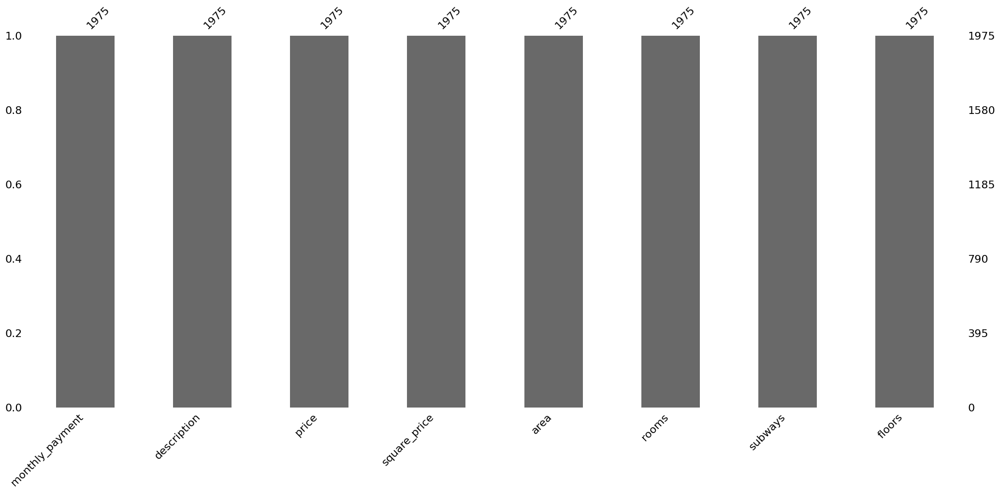

In [35]:
msno.bar(full)
plt.show()

In [51]:
missing_columns = [col for col in full.columns if full[col].isnull().sum() > 0]
missing_columns

[]

Построение графиков зависимости цены квдаратного метра от каждой колонки 

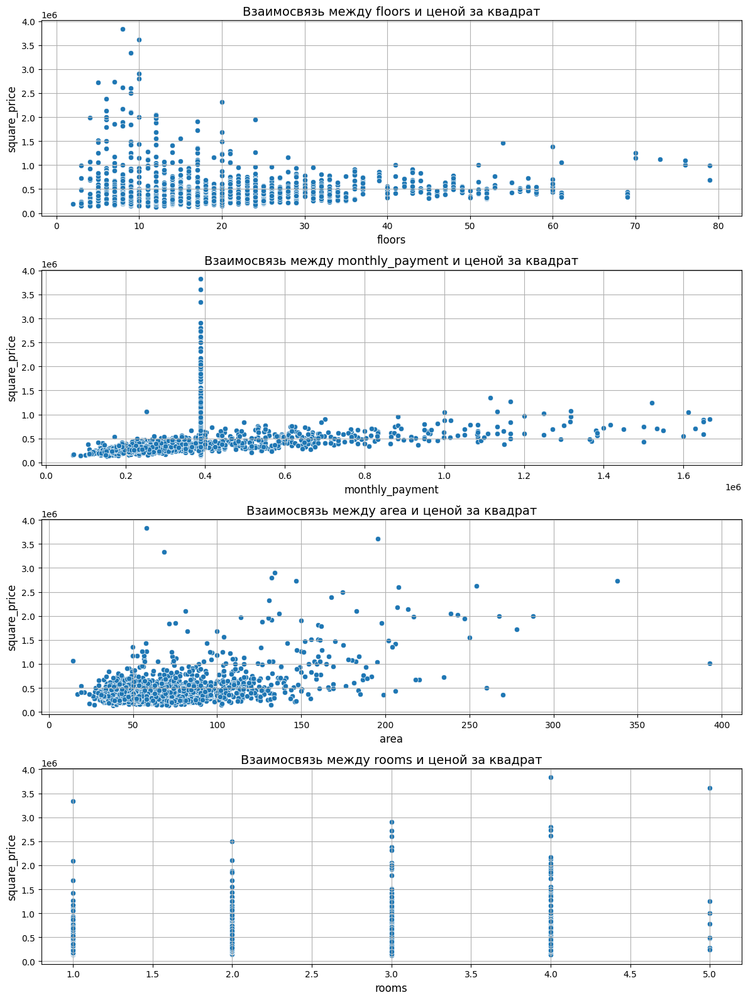

In [43]:
import matplotlib.pyplot as plt
import seaborn as sns

columns_to_plot = ['floors', 'monthly_payment', 'area', 'rooms']
num_columns = len(columns_to_plot)

# Настройка общего размера графиков
plt.figure(figsize=(12, 4 * num_columns))

for i, column in enumerate(columns_to_plot):
    plt.subplot(num_columns, 1, i + 1)  # Создание подграфиков
    sns.scatterplot(data=full, x=column, y='square_price')
    plt.title(f'Взаимосвязь между {column} и ценой за квадрат', fontsize=14)
    plt.xlabel(column, fontsize=12)
    plt.ylabel('square_price', fontsize=12)
    plt.grid(True)  # Добавление сетки для удобства восприятия

plt.tight_layout()  # Автоматическая настройка отступов
plt.show()

Корреляционная матрица

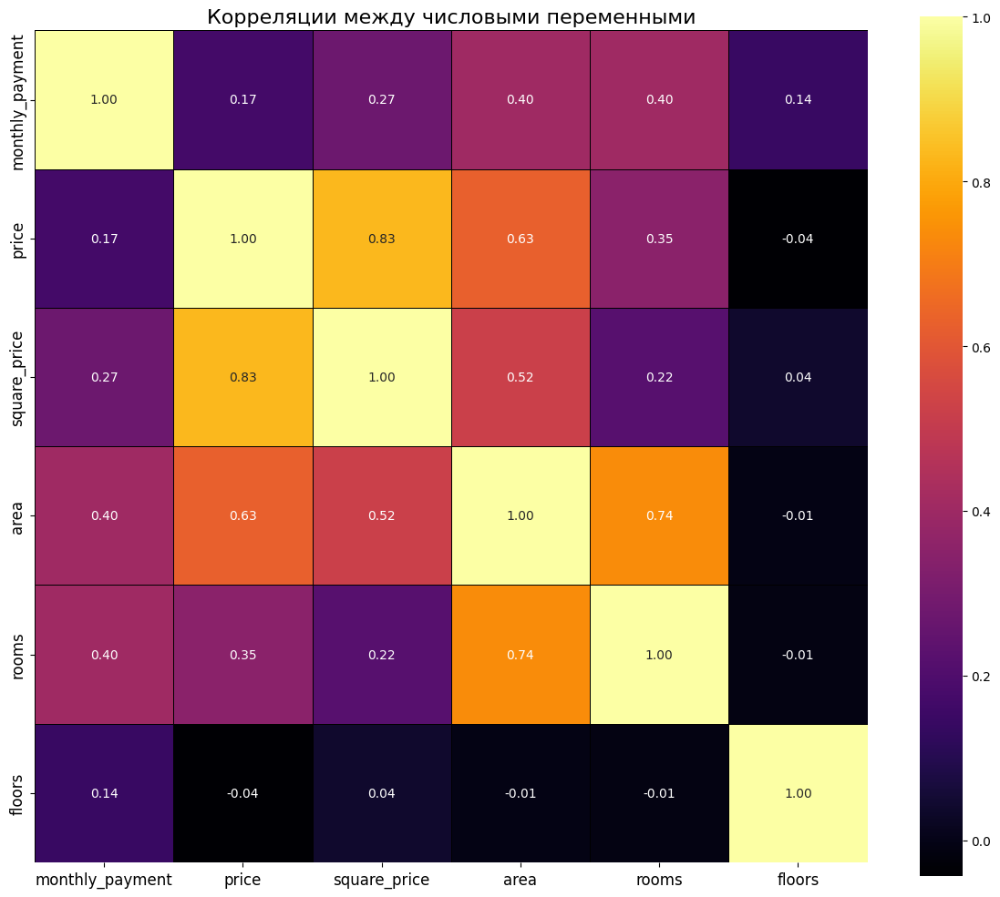

In [44]:
import matplotlib.pyplot as plt
import seaborn as sns

# Выбор числовых переменных
numeric_df = full.select_dtypes(include=['float64', 'int64'])

# Настройка размера фигуры
plt.figure(figsize=(12, 10))

# Построение тепловой карты корреляций
heatmap = sns.heatmap(
    numeric_df.corr(),
    annot=True,
    fmt=".2f",  # Формат аннотаций до двух знаков после запятой
    cmap='inferno',
    cbar=True,  # Отображение цветовой легенды
    square=True,  # Квадратные ячейки
    linewidths=0.5,  # Ширина линий между ячейками
    linecolor='black'  # Цвет линий между ячейками
)

# Настройка заголовка и шрифтов
plt.title('Корреляции между числовыми переменными', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Показ графика
plt.tight_layout()  # Автоматическая настройка отступов
plt.show()

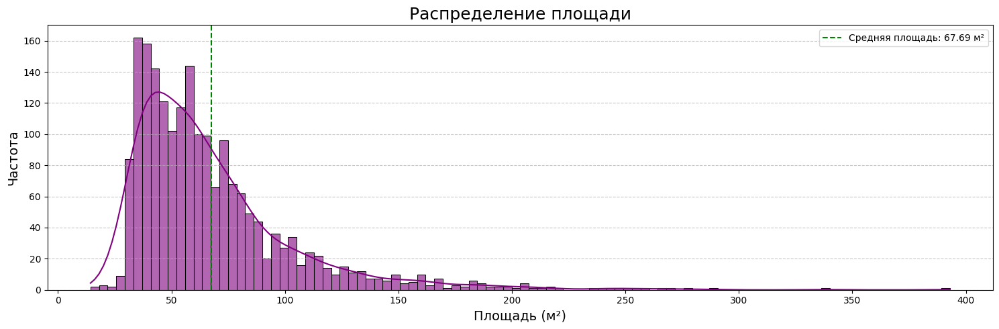

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Настройка размера фигуры
plt.figure(figsize=(15, 5))

# Построение гистограммы 
sns.histplot(
    full['area'], 
    bins=100, 
    kde=True, 
    color='purple',  # Цвет гистограммы
    alpha=0.6,  # Прозрачность гистограммы
)

# Добавление заголовка и меток осей
plt.title('Распределение площади', fontsize=18)
plt.xlabel('Площадь (м²)', fontsize=14)
plt.ylabel('Частота', fontsize=14)

# Добавление сетки
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Добавление вертикальной линии для среднего значения
mean_area = full['area'].mean()
plt.axvline(mean_area, color='green', linestyle='--', label=f'Средняя площадь: {mean_area:.2f} м²')
plt.legend()

# Показ графика
plt.tight_layout()  # Автоматическая настройка отступов
plt.show()

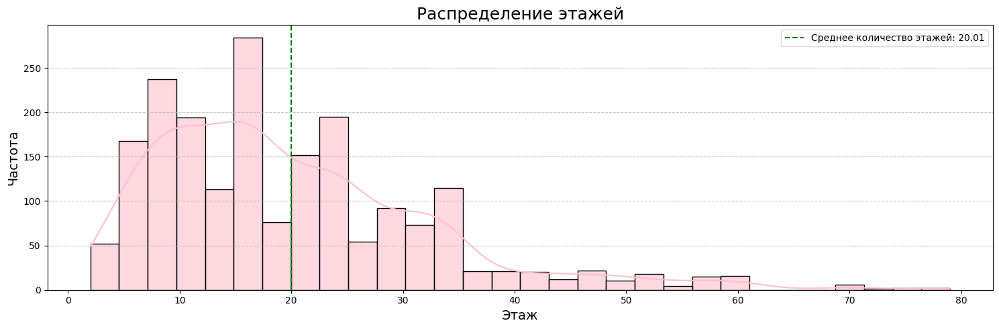

In [48]:
import matplotlib.pyplot as plt
import seaborn as sns

# Настройка размера фигуры
plt.figure(figsize=(15, 5))

# Построение гистограммы
sns.histplot(
    full['floors'], 
    bins=30,  # Уменьшено количество бинов для лучшего восприятия
    kde=True, 
    color='pink',  # Цвет гистограммы
    alpha=0.6,  # Прозрачность гистограммы
)

# Добавление заголовка и меток осей
plt.title('Распределение этажей', fontsize=18)
plt.xlabel('Этаж', fontsize=14)
plt.ylabel('Частота', fontsize=14)

# Добавление сетки
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Добавление вертикальной линии для среднего значения
mean_floors = full['floors'].mean()
plt.axvline(mean_floors, color='green', linestyle='--', label=f'Среднее количество этажей: {mean_floors:.2f}')
plt.legend()

# Показ графика
plt.tight_layout()  # Автоматическая настройка отступов
plt.show()

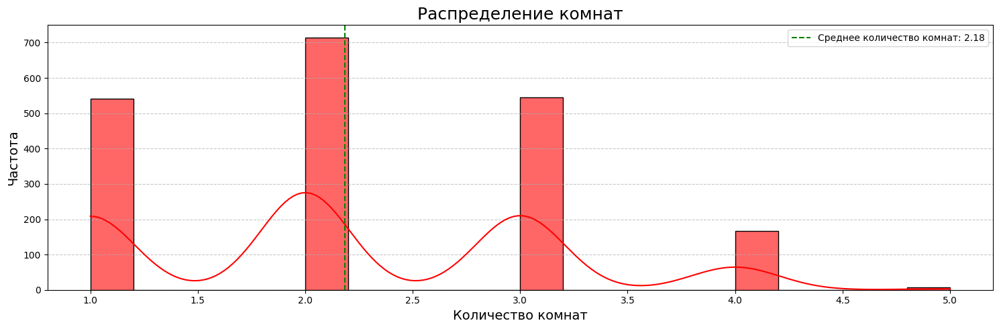

In [49]:
import matplotlib.pyplot as plt
import seaborn as sns

# Настройка размера фигуры
plt.figure(figsize=(15, 5))

# Построение гистограммы
sns.histplot(
    full['rooms'], 
    bins=20,  # Уменьшено количество бинов для лучшего восприятия
    kde=True, 
    color='red',  # Цвет гистограммы
    alpha=0.6,  # Прозрачность гистограммы
)

# Добавление заголовка и меток осей
plt.title('Распределение комнат', fontsize=18)
plt.xlabel('Количество комнат', fontsize=14)
plt.ylabel('Частота', fontsize=14)

# Добавление сетки
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Добавление вертикальной линии для среднего значения
mean_rooms = full['rooms'].mean()
plt.axvline(mean_rooms, color='green', linestyle='--', label=f'Среднее количество комнат: {mean_rooms:.2f}')
plt.legend()

# Показ графика
plt.tight_layout()  # Автоматическая настройка отступов
plt.show()

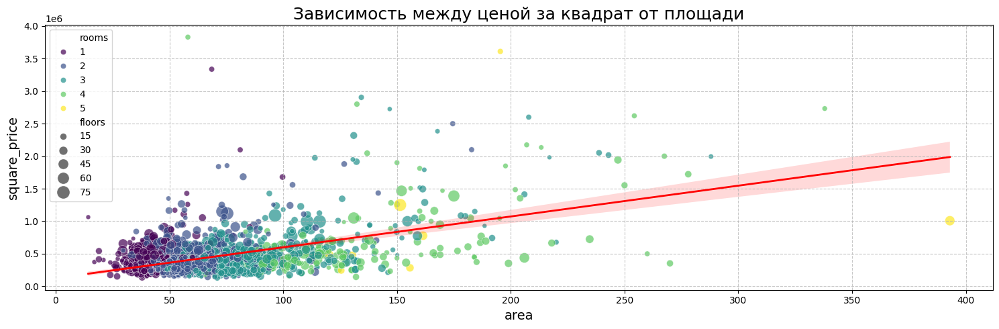

In [50]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Настройка размера фигуры
plt.figure(figsize=(15, 5))

# Построение диаграммы рассеяния
sns.scatterplot(data=full, x='area', y='square_price', 
                hue='rooms',  # Используем количество комнат для цвета
                size='floors',  # Используем количество этажей для размера точек
                sizes=(20, 200),  # Размеры точек
                palette='viridis',  # Цветовая палитра
                alpha=0.7,  # Прозрачность точек
                edgecolor='w'  # Цвет границы точек
               )

# Добавление заголовка и меток осей
plt.title('Зависимость между ценой за квадрат от площади', fontsize=18)
plt.xlabel('Площадь (м²)', fontsize=14)
plt.ylabel('Цена за квадратный метр', fontsize=14)

# Добавление сетки
plt.grid(True, linestyle='--', alpha=0.7)

# Добавление линии регрессии
sns.regplot(data=full, x='area', y='square_price', scatter=False, color='red', line_kws={'linewidth': 2})

# Показ графика
plt.tight_layout()  # Автоматическая настройка отступов
plt.show()


Закончили с анализом данных в коде